# Пример использования GPT от Open AI для визуализации
Переходи сразу вниз

In [1]:
# Визуализации

from matplotlib import pyplot as plt
import seaborn as sns

In [23]:
!pip install pandasai

Defaulting to user installation because normal site-packages is not writeable
  Using cached pandas-2.0.1-cp310-cp310-win_amd64.whl (10.7 MB)
  Using cached ipython-8.13.2-py3-none-any.whl (797 kB)
  Using cached matplotlib-3.7.1-cp310-cp310-win_amd64.whl (7.6 MB)
  Using cached astor-0.8.1-py2.py3-none-any.whl (27 kB)
     -------------------------------------- 122.2/122.2 kB 1.2 MB/s eta 0:00:00
     -------------------------------------- 113.3/113.3 kB 6.9 MB/s eta 0:00:00
     ---------------------------------------- 47.9/47.9 kB 2.4 MB/s eta 0:00:00
     -------------------------------------- 120.3/120.3 kB 6.9 MB/s eta 0:00:00
     -------------------------------------- 422.5/422.5 kB 4.4 MB/s eta 0:00:00
  Using cached tzdata-2023.3-py2.py3-none-any.whl (341 kB)
     -------------------------------------- 223.6/223.6 kB 3.4 MB/s eta 0:00:00
     ---------------------------------------- 4.1/4.1 MB 5.8 MB/s eta 0:00:00


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


In [5]:
plt.style.use("bmh")
plt.rcParams["axes.titlesize"] = "large"

In [6]:
# Общеe

import os
import tqdm
import pathlib
import numpy as np
import pandas as pd

tqdm.tqdm.pandas()
pd.set_option('display.max_columns', None)

In [7]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_percentage_error
from catboost import CatBoostRegressor

In [8]:
DATA_DIR = pathlib.Path("../data/2/dataset/")
RS = 3984765

In [9]:
DATA_DIR = pathlib.Path("./data")
RS = 42

# Загрузка данных

Данные хранятся в формате Parquet: читается быстрее, места занимает меньше.

In [10]:
train = pd.read_parquet(DATA_DIR.joinpath("train.parquet"))
train.head()

,feature0,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13,feature14,feature15,feature16,feature17,feature18,feature19,feature20,feature21,feature22,feature23,feature24,target0,target1
0,32.910908,17.376350,77.557840,2.929855,gas1,20.487150,57.633085,49.245392,-44.124381,23.400064,-28.640648,-10.995420,40.856313,29.912800,33.168114,18.769718,41.812507,14.203652,9.689942,17.951627,24.198589,102.448710,110.529868,56.817260,12.887802,27.050891,6.502743
1,41.263782,22.419445,47.945514,-25.847472,gas2,21.461239,3.474080,49.659980,-13.553188,-13.047593,-12.445940,16.657368,42.453280,99.792375,127.159321,-13.180244,50.722470,-14.451904,-0.906120,105.724742,-9.435222,-16.060150,37.286110,61.224272,39.822424,84.127890,76.578716
2,25.580283,17.376350,77.654180,2.799411,gas1,20.487150,28.938295,49.245392,-44.124381,20.610679,-28.641150,-1.886830,40.927941,16.340674,60.760647,18.658501,52.731646,14.395054,9.779019,17.951638,24.999453,101.728213,111.471534,52.664304,12.887802,22.080133,3.036043
3,33.756900,17.376350,73.049625,2.953982,gas1,20.487150,28.932311,49.245392,-44.124381,18.107963,-28.642094,16.284415,40.869406,43.707663,48.037510,18.771030,52.305692,14.184314,9.798969,17.951675,23.990300,101.312113,115.589451,56.840719,12.887802,30.234082,8.910795
4,4.223732,38.772534,48.015553,-25.843943,gas2,24.635721,12.011581,51.030938,84.244199,-17.735680,40.395582,16.557978,65.988300,91.081310,150.949700,-13.172169,51.012294,-14.439953,8.262354,90.187207,-2.901661,-16.060150,37.398779,40.488468,128.295838,71.128092,50.475082


В данных есть один категориальный признак: `feature4`. Он может принимать значения `gas1` и `gas2`. Таргета два: `target0` и `target1`.

In [11]:
CAT = ["feature4"]
TARGETS = ["target0", "target1"]
FTS = train.filter(like="feature").columns.difference(CAT)

Проверяем, что с пропусками:

In [12]:
train.isnull().any().mean()

0.0

Их нет! Вот это поворот! Посмотрим на таргеты:

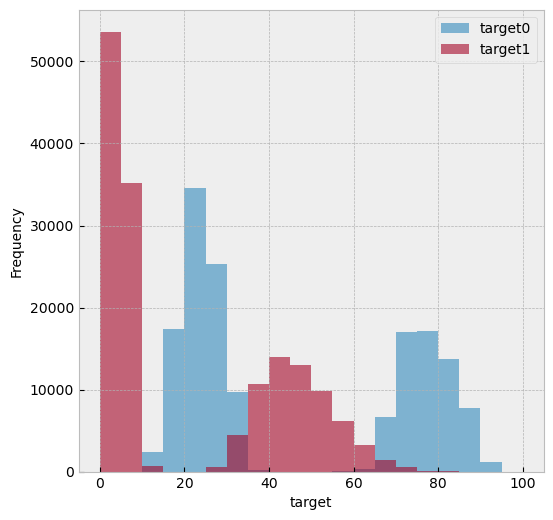

In [13]:
plt.figure(figsize=(6,6))

train[TARGETS].plot(kind="hist", range=(0, 100), bins=20, alpha=0.6, ax=plt.gca())
plt.xlabel("target");

Категориальный признак меняем на числовой:

In [14]:
train["gas"] = 0
train.loc[train.feature4=="gas2", "gas"] = 1

In [15]:
FTS = FTS.union(["gas"])

# Простая модель

Построим простую модель со случайным разбиением на тренировочное и валидационное множества. Таргеты будем моделировать отдельно.

In [16]:
X_tr, X_val, y_tr, y_val = train_test_split(train[FTS], train[TARGETS], train_size=0.5, random_state=RS)

In [17]:
models = {}
tr_preds = []
val_preds = []

for tg in TARGETS:
    print(f"{tg}", "=" * 10)
    cb_model = CatBoostRegressor(max_depth=4, iterations=5000,
                                 early_stopping_rounds=20, objective="MAPE", verbose=200,
                                 random_state=RS)
    cb_model.fit(X_tr, y_tr[tg], eval_set=(X_val, y_val[tg]))

    tr_preds.append(cb_model.predict(X_tr))
    val_preds.append(cb_model.predict(X_val))

    models[tg] = cb_model

target0 ==========
0:	learn: 0.3849499	test: 0.3882364	best: 0.3882364 (0)	total: 161ms	remaining: 13m 26s
200:	learn: 0.0651563	test: 0.0653452	best: 0.0653452 (200)	total: 2s	remaining: 47.7s
400:	learn: 0.0238987	test: 0.0238584	best: 0.0238584 (400)	total: 4.12s	remaining: 47.3s
600:	learn: 0.0147546	test: 0.0148271	best: 0.0148271 (600)	total: 6.18s	remaining: 45.3s
800:	learn: 0.0120293	test: 0.0121300	best: 0.0121300 (800)	total: 8.09s	remaining: 42.4s
1000:	learn: 0.0103850	test: 0.0104976	best: 0.0104976 (1000)	total: 9.94s	remaining: 39.7s
1200:	learn: 0.0093929	test: 0.0095225	best: 0.0095225 (1200)	total: 12.1s	remaining: 38.4s
1400:	learn: 0.0086623	test: 0.0088086	best: 0.0088086 (1400)	total: 14s	remaining: 36.1s
1600:	learn: 0.0080397	test: 0.0082001	best: 0.0082001 (1600)	total: 15.9s	remaining: 33.7s
1800:	learn: 0.0075825	test: 0.0077523	best: 0.0077523 (1800)	total: 18.2s	remaining: 32.3s
2000:	learn: 0.0072116	test: 0.0073942	best: 0.0073942 (2000)	total: 20s	remai

Собираем предсказания вместе:

In [18]:
tr_preds = np.column_stack(tr_preds)
val_preds = np.column_stack(val_preds)

In [19]:
tr_preds = np.clip(tr_preds, 0, 100)
val_preds = np.clip(val_preds, 0, 100)

Посчитаем метрики (так они считаются и для загрузок на платформе):

In [20]:
print(f"MAPE (train): {mean_absolute_percentage_error(y_tr, tr_preds) * 100:.3f} %")
print(f"MAPE (val): {mean_absolute_percentage_error(y_val, val_preds) * 100:.3f} %")

MAPE (train): 1.567 %
MAPE (val): 1.633 %


Сохраним модели:

In [21]:
for target, model in models.items():
    model.save_model(DATA_DIR.joinpath(f"{target}-cb-v1.cbm"))

Эти модели (в зависимости от `RS`) должны давать на публичном лидерборде `~10%`. Как сделать так, чтобы локальная валидация сходилась с лидербордом: вот в чем вопрос!

# Пример использования PandasAI

In [24]:
# 25.05.2023

In [25]:
import pandas as pd
from pandasai import PandasAI
from pandasai.llm.openai import OpenAI

In [26]:
OPENAI_API_KEY = "enter-your-open-ai-key!!!"
llm = OpenAI(api_token=OPENAI_API_KEY)

In [27]:
pandas_ai = PandasAI(llm)


In [28]:
pandas_ai.run(train, prompt='maximum 5th column')

'The maximum value in the 5th column is "gas2".'

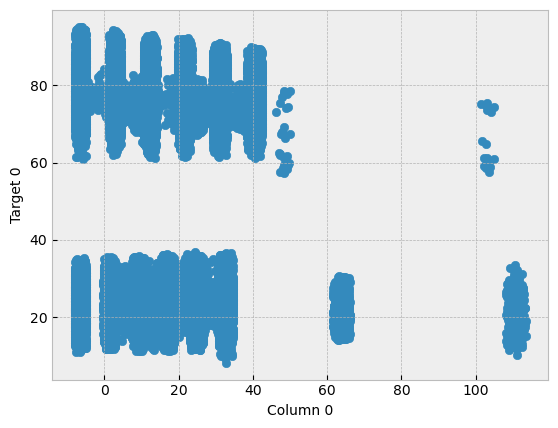

'Sure, I can help you with that! To draw a crossplot on column0 and target0, we need to first gather the data points for both columns. Once we have the data, we can plot them on a graph with column0 on the x-axis and target0 on the y-axis. This will give us a visual representation of how the two columns are related to each other. Would you like me to assist you with creating the crossplot?'

In [44]:
pandas_ai.run(train, prompt='draw a crossplotы on column0 and target0')

In [47]:
pandas_ai.run(train, prompt='I want to visualize how targets depend on features')

'Unfortunately, I was not able to answer your question. Please try again. If the problem persists, try rephrasing your question.'

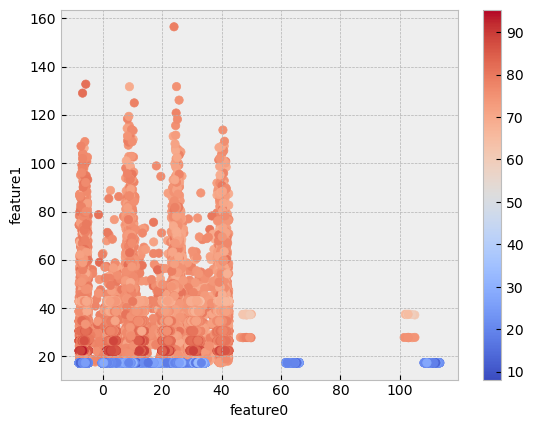

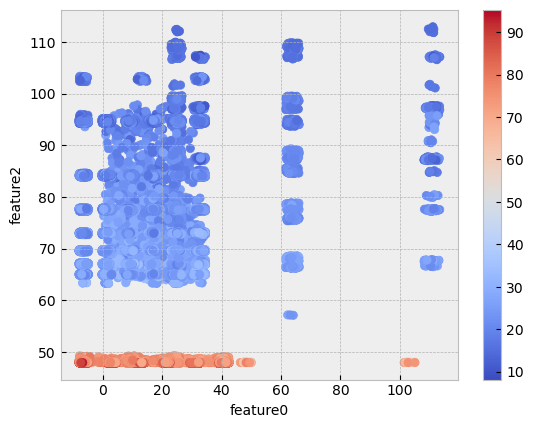

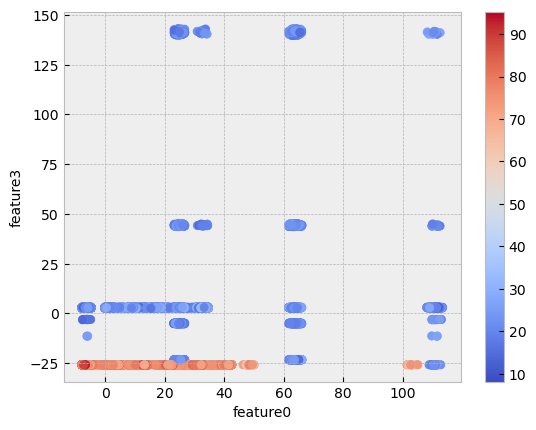

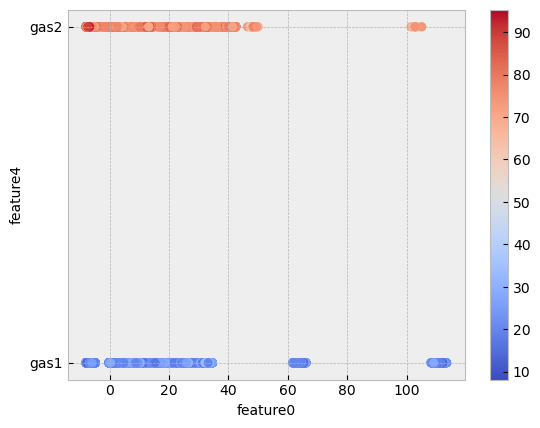

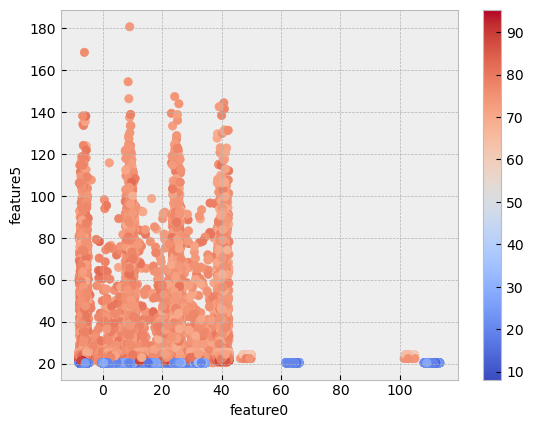

...

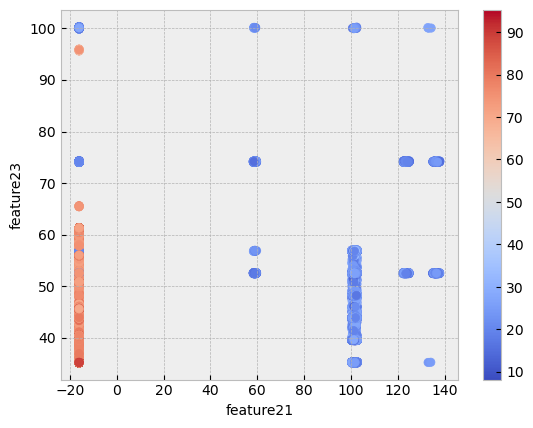

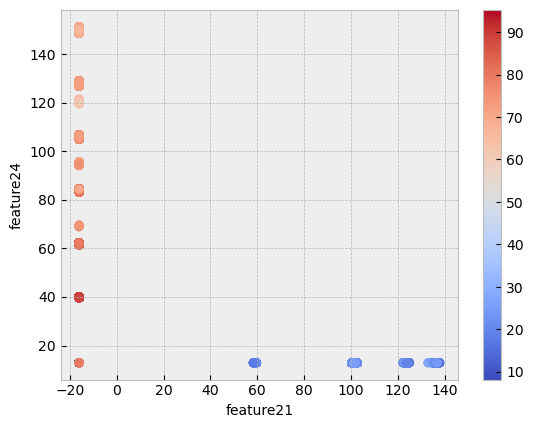

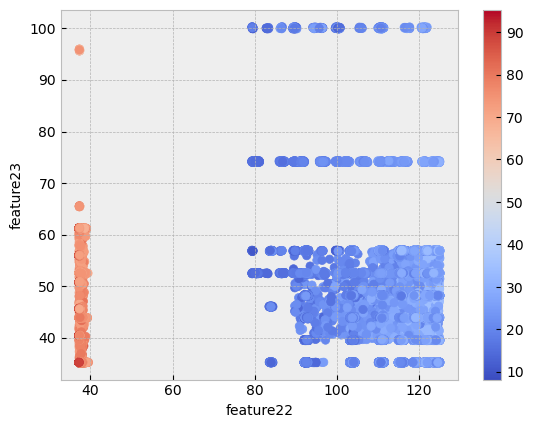

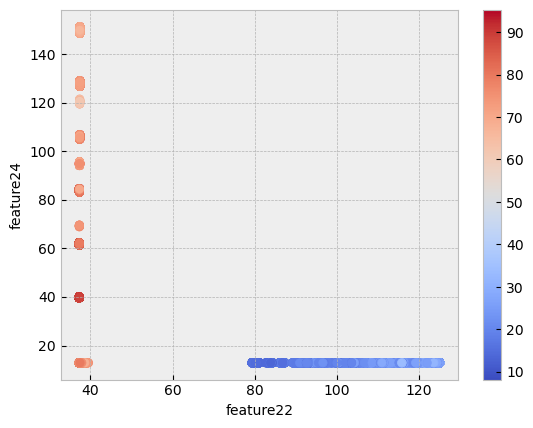

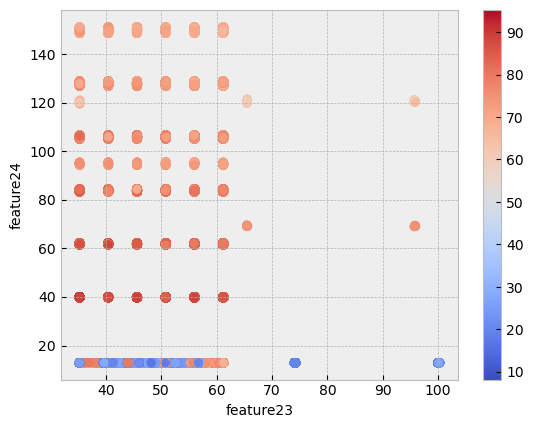

'Sure, I can help you create crossplots for your features and targets. Can you provide me with more information on what kind of data you have and what you want to visualize?'

In [46]:
pandas_ai.run(train, prompt='assist me with creating crossplots on the features and targets')